# Spotify Univariate Exploratory Data Analysis

In this notebook I will be performing some exploratory data analysis on a data set of songs taken from Spotify's API from the years 1921 to 2020. Some questions that I hope to answer are:
 - What artist has the most songs on Spotify?
 - What artist is the most popular on Spotify?
 - What songs had the highest popularity rating?
 - What songs had the slowest or fastest tempo?
 - How many songs contained explicit or non-explicit content?
 - What year had the most songs being released?
 
These questions are just a few among many others that I have about the data set and hope to explore.

In [1]:
# Import necessary libraries

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
print('libraries imported')

libraries imported


In [2]:
# @hidden_cell
# Import data set
import types

from botocore.client import Config
import ibm_boto3

def __iter__(self): return 0


# The following code accesses a file in your IBM Cloud Object Storage. It includes your credentials.
# You might want to remove those credentials before you share the notebook.
client_aa0682dac2ea46708a76c09ecac60e99 = ibm_boto3.client(service_name='s3',
    ibm_api_key_id='OQ7E-F2EpeAr2rMGAtJtZWmzVBrRQ0ePT4o3uNqhMC6g',
    ibm_auth_endpoint="https://iam.cloud.ibm.com/oidc/token",
    config=Config(signature_version='oauth'),
    endpoint_url='https://s3-api.us-geo.objectstorage.service.networklayer.com')

body = client_aa0682dac2ea46708a76c09ecac60e99.get_object(Bucket='spotify-donotdelete-pr-riayigqj1y9rsh',Key='Spotify Data.csv')['Body']
# add missing __iter__ method, so pandas accepts body as file-like object
if not hasattr(body, "__iter__"): body.__iter__ = types.MethodType( __iter__, body )

df = pd.read_csv(body)



In [3]:
# Convert release_date feature from object to date time
df['release_date'] = pd.to_datetime(df['release_date'])

# Create a new column based solely on the year of the new date time
df['year'] = df['release_date'].dt.year

# Drop old release_date column
df = df.drop(columns = 'release_date', axis = 1, inplace = False)

# Drop the id column
df = df.drop(columns = 'id', axis = 1, inplace = False)

# Convert duration_ms to duration_s
df['duration'] = round(df['duration_ms']/(1000),2)

# Drop old duration_ms column
df = df.drop(columns = 'duration_ms', axis = 1, inplace = False)

# View the first five rows of the data set after all the edits
df.head()

,acousticness,artists,danceability,energy,explicit,instrumentalness,key,liveness,loudness,mode,name,popularity,speechiness,tempo,valence,year,duration
0,0.991000,['Mamie Smith'],0.598,0.224,0,0.000522,5,0.3790,-12.628,0,Keep A Song In Your Soul,12,0.0936,149.976,0.6340,1920,168.33
1,0.643000,"[""Screamin' Jay Hawkins""]",0.852,0.517,0,0.026400,5,0.0809,-7.261,0,I Put A Spell On You,7,0.0534,86.889,0.9500,1920,150.20
2,0.993000,['Mamie Smith'],0.647,0.186,0,0.000018,0,0.5190,-12.098,1,Golfing Papa,4,0.1740,97.600,0.6890,1920,163.83
3,0.000173,['Oscar Velazquez'],0.730,0.798,0,0.801000,2,0.1280,-7.311,1,True House Music - Xavier Santos & Carlos Gomi...,17,0.0425,127.997,0.0422,1920,422.09
4,0.295000,['Mixe'],0.704,0.707,1,0.000246,10,0.4020,-6.036,0,Xuniverxe,2,0.0768,122.076,0.2990,1920,165.22


## Now that the data wrangling and cleaning is done, we can move to the first of many questions, "What year had the most released songs"?

In [4]:
# Graphically display year and songs
fig = px.histogram(df, x = 'year', nbins = 100, title = 'No of Songs per Year', color_discrete_sequence = ['darkorange'])
fig.show()

In [5]:
# Graphically examine the number of songs and danceability
fig = px.histogram(df, x = 'danceability', nbins = 25, title = 'No. of Songs and Danceability', color_discrete_sequence = ['darkorange'])
fig.show()
print('The average level of danceability is', round(np.mean(df['danceability']),2))

The average level of danceability is 0.54


In [6]:
# Graphically examine the number of songs and duration
fig = px.histogram(df, x = 'duration', nbins = 100, title = 'No. of Songs and Song Duration(s)', color_discrete_sequence = ['darkorange'])
fig.show()
print('The average duration in seconds of a song is', (np.mean(df['duration'])),'seconds')

The average duration in seconds of a song is 232.8100249442339 seconds


In [7]:
# Display the measures of central tendency
df['duration'].describe()

count    174389.000000
mean        232.810025
std         148.395803
min           4.940000
25%         166.130000
50%         205.790000
75%         265.720000
max        5338.300000
Name: duration, dtype: float64

From the measures of central tendency we see that the average song length is 232.81 seconds with a standard deviation of 148.4 seconds. The median duration of a song is 205.79 seconds.

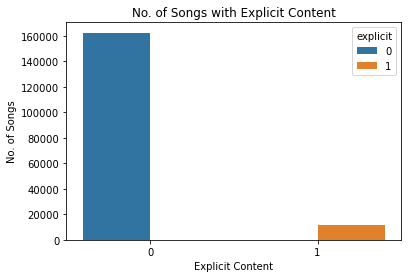

0    162507
1     11882
Name: explicit, dtype: int64


In [8]:
# Graphically examin the number of songs with explicit content
ax = sns.countplot(x = 'explicit', data = df, hue = 'explicit')
ax.set(xlabel = 'Explicit Content', ylabel = 'No. of Songs', title = 'No. of Songs with Explicit Content')
plt.show()
print(df['explicit'].value_counts())

In [ ]:
# Graphically examine the number of songs in each octave key C, C#, ...
df_keys = df.copy()
keys = ['C', 'C#', 'D', 'D#', 'E', 'F', 'F#', 'G', 'G#', 'A', 'A#', 'B']
for index in range(len(df)):
    for key_index in range(len(keys)):
        if df['key'][index] == key_index:
            df_keys['key'][index] = keys[key_index]
            
fig = px.histogram(df_keys, x = df_keys.key, title = 'No. of Songs in Each Key', color_discrete_sequence = ['darkorange'],category_orders = {
    'key': ['C', 'C#', 'D', 'D#', 'E', 'F', 'F#', 'G', 'G#', 'A', 'A#', 'B']})
fig.show()

/opt/conda/envs/Python-3.7-main/lib/python3.7/site-packages/ipykernel/__main__.py:7: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/opt/conda/envs/Python-3.7-main/lib/python3.7/site-packages/pandas/core/indexing.py:671: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
# Graphically examine the number of songs written in a minor key or a major key
sns.countplot(x = 'mode', data = df)
ax.set(xlabel = 'Modality', ylabel = 'No. of Songs', title = 'No. of Songs in Major and Minor Keys')
plt.show()
print(df['mode'].value_counts())

In [ ]:
# Graphically examine the number of songs and loundness
fig = px.histogram(df, x = 'loudness', nbins  = 50, title = 'Decible level and No. of Songs', color_discrete_sequence = ['darkorange'])
fig.show()
print('The average decible level is', round(np.mean(df['loudness']),2))

In [ ]:
# Look at the measures of central tendency
df['loudness'].describe()

We can see from the measures of central tendency that the average decible level is -11.75db with a standard deviation of 5.69db. The median decible level is -10.84db.

In [ ]:
# Graphically examine the number of songs with specific tempos
fig = px.histogram(df, x = 'tempo', nbins = 100, title = 'No. of Songs Regarding Tempo', color_discrete_sequence = ['darkorange'])
fig.show()
print('The average tempo of a song is', round(np.mean(df['tempo']),2), 'beats per minute(bpm)')

In [ ]:
# Display the measures of central tendency for tempo
round(df['tempo'].describe(),2)

The average tempo for a song is 117.01 bpm with a standard deviation of 30.25 bpm. The median tempo of a song is 115.82 bpm

In [ ]:
# Graphically examine the number of songs and popularity
fig = px.histogram(df, x = 'popularity', nbins = 25, title = 'No. of Songs and Popularity Level', color_discrete_sequence = ['darkorange'])
print('The average level of popularity is', round(np.mean(df['popularity']),2))
fig.show()

In [ ]:
# Display measures of central tendency for popularity
round(df['popularity'].describe(),2)

According to the measures of central tendency we see that the average popularity level of a song is 25.69 with a standard deviation of 21.87. The median popularity level of all the songs is 25.

In [ ]:
# Graphically examin the number of songs with acousticness
fig = px.histogram(df, x = 'acousticness', title = 'No of Songs and Acousticness Level', color_discrete_sequence = ['darkorange'])
fig.show()
print('The average acousticness level is', round(np.mean(df['acousticness']),2))

In [ ]:
# Graphically examine the lvel of energy in songs
fig = px.histogram(df, x = 'energy', title = 'No. of Songs and Energy Level', nbins = 100, color_discrete_sequence = ['darkorange'])
fig.show()
print('The average level of energy of a song is', round(np.mean(df['energy']),2))

In [ ]:
# Graphically examine the level of instrumentalness in songs
fig = px.histogram(df, x = 'instrumentalness', title = 'No. of Songs and Instrumentalness Level', nbins = 100, color_discrete_sequence = ['darkorange'])
fig.show()
print('The average level of instrumentalness of a song is', round(np.mean(df['instrumentalness']),2))

In [ ]:
# Graphically examine the level of valence in songs
fig = px.histogram(df, x = 'valence', title = 'No. of Songs and Valence Level', nbins = 100, color_discrete_sequence = ['darkorange'])
fig.show()
print('The average level of valence of a song is', round(np.mean(df['valence']),2))

In [ ]:
# Graphically examine the level of liveness in songs
fig = px.histogram(df, x = 'liveness', title = 'No. of Songs and Liveness Level', nbins = 100, color_discrete_sequence = ['darkorange'])
fig.show()
print('The average level of liveness in a song is', round(np.mean(df['liveness']),2))

In [ ]:
# Graphically examine the level of speechiness in the songs
fig = px.histogram(df, x = 'speechiness', nbins = 100, title = 'No of Songs with Speechiness', color_discrete_sequence = ['darkorange'])
fig.show()
print('The average level of speechiness is', round(np.mean(df['speechiness']),2))

## Conclusions

 - In the year 2020 there were 6134 songs released. This was the largest number of songs released from 1921 to 2020. In comparison, from 1922 to 1923 there were only 306 songs that were released, making for the lowest amount of songs released. It could also be of note that from 1948 till about 1965 there number of songs released remained relatively uniform, being only around 4000.
 - The distribution of the number of songs and their duration in milliseconds is incredibly right skewed. I converted the average duration of a song to seconds which was 232.81 seconds. To get a further insight into the duration of a song, I am going to run some descriptive statistics(measures of central tendency) after converting the column temporarily to seconds
 - According to the bar graph there are 162507 songs that are considered "clean" without any explicit content. In addition, there are 11882 songs that have explicit content
 - The above graph shows that there are 122488 songs written in a major key. There are 51901 written in a minor key
 - The distribution of the graph regarding the number of songs and their popularity is approximately right skewed with an average level of 25.69. Again, to provide more insight we will look into the measures of central tendency.
 - The graph shows that there are 21967 songs composed in the key of C closely followed by 21363 songs composed in the key of G. The key of D# and F# have the least number with 7280 and 9226 respectively
 - The shape of the histogram regarding danceability is approximately normal, centered around the average level of danceability of .54
 

